# First pipeline using `pytesseract` package

---

To install tesseract on Ubuntu I used : https://www.datacorner.fr/tesseract/

## Import package

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from dyslexia import preprocessing
from dyslexia.io import load_image
from dyslexia.ocr import extract_text_from_image
from dyslexia.plots import plot_image, plot_2_images

import os
from os.path import join, isdir, isfile
from os import listdir
import time

import cv2
import numpy as np
import matplotlib.pyplot as plt

In [3]:
%env TESSDATA_PREFIX /usr/share/tesseract-ocr/4.00/tessdata/

env: TESSDATA_PREFIX=/usr/share/tesseract-ocr/4.00/tessdata/


## List examples files

In [4]:
# Get all directories with examples
example_path = '../Exemples/'
subdir_paths = [
    join(example_path, p) 
    for p in listdir(example_path) 
    if isdir(join(example_path, p))
]

# Retrieves all files in example dir
all_files = []
for p in [example_path] + subdir_paths:
    _files = [join(p, f) for f in listdir(p) if isfile(join(p, f))]
    
    all_files = all_files + _files
    

# Keeps only jpg extension files
all_files = [f for f in all_files if f[-3:] in ['jpg']]

all_files

['../Exemples/Ex_Maths/IMG_20210329_123828.jpg',
 '../Exemples/Ex_Maths/IMG_20210329_122221.jpg',
 '../Exemples/Ex_Maths/IMG_20210329_123818.jpg',
 '../Exemples/Ex_Maths/IMG_20210329_122227.jpg',
 '../Exemples/Ex_Maths/IMG_20210329_122202.jpg',
 '../Exemples/Ex_Maths/IMG_20210329_122715.jpg',
 '../Exemples/Ex_Maths/IMG_20210329_122724.jpg',
 '../Exemples/Ex_Maths/IMG_20210329_123813.jpg',
 '../Exemples/Ex_Maths/IMG_20210329_122157.jpg',
 '../Exemples/Ex_Maths/IMG_20210329_122738.jpg',
 '../Exemples/Histoire_Geo/IMG_20210329_122543.jpg',
 '../Exemples/Histoire_Geo/IMG_20210329_123005.jpg',
 '../Exemples/Histoire_Geo/IMG_20210329_122940.jpg',
 '../Exemples/Histoire_Geo/IMG_20210329_123000.jpg',
 '../Exemples/Histoire_Geo/IMG_20210329_122932.jpg',
 '../Exemples/Histoire_Geo/IMG_20210329_122524.jpg',
 '../Exemples/Histoire_Geo/IMG_20210329_122536.jpg',
 '../Exemples/Dictee/IMG_20210329_122324.jpg',
 '../Exemples/Dictee/IMG_20210329_122825.jpg',
 '../Exemples/Dictee/IMG_20210329_122839.jpg'

In [5]:
subdir_paths

['../Exemples/Ex_Maths',
 '../Exemples/Histoire_Geo',
 '../Exemples/Dictee',
 '../Exemples/SVT',
 '../Exemples/Ex_COD',
 '../Exemples/Present_indicatif']

## Try pytesseract usage

More details on the Pypi page : https://pypi.org/project/pytesseract/

In [ ]:
subdir = subdir_paths[3]

print('Directory:', subdir)
results = {}

for fpath in [f for f in all_files if subdir in f]:
    print(fpath)
    res = {}
    t0 = time.time()
    
    img = load_image(fpath)
    
    text = extract_text_from_image(img)
    
    t_end = time.time() - t0
    print('end in %.1fs'%t_end)
    
    res['time'] = t_end
    res['text'] = text
    res['img'] = img
    
    results[fpath] = res
    

Directory: ../Exemples/SVT
../Exemples/SVT/IMG_20210329_123138.jpg
end in 6.3s
../Exemples/SVT/IMG_20210329_122617.jpg
end in 5.8s
../Exemples/SVT/IMG_20210329_122614.jpg
end in 5.6s
../Exemples/SVT/IMG_20210329_123021.jpg
end in 5.7s
../Exemples/SVT/IMG_20210329_122633.jpg
end in 5.6s
../Exemples/SVT/IMG_20210329_122621.jpg
end in 5.9s
../Exemples/SVT/IMG_20210329_122629.jpg


In [ ]:
# for k, res in results.items():
#     print(k)
#     print()
#     print(res['text'])
#     print()
#     print('==============================')

## Preprocessing on differents images

In [44]:
img_to_try = [
    '../Exemples/Ex_Maths/IMG_20210329_122221.jpg',
    '../Exemples/Ex_COD/IMG_20210329_122755.jpg',
    '../Exemples/SVT/IMG_20210329_122633.jpg',
    '../Exemples/Dictee/IMG_20210329_122825.jpg',
    '../Exemples/SVT/IMG_20210329_123021.jpg',
    '../Exemples/Ex_Maths/IMG_20210329_123813.jpg',
    '../Exemples/Histoire_Geo/IMG_20210329_123005.jpg',
    '../Exemples/Histoire_Geo/IMG_20210329_122940.jpg',
    '../Exemples/Present_indicatif/IMG_20210329_122406.jpg',
    '../Exemples/Present_indicatif/IMG_20210329_122915.jpg',
]

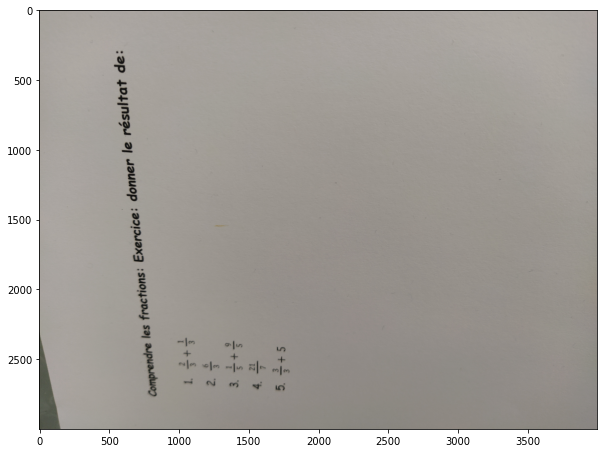

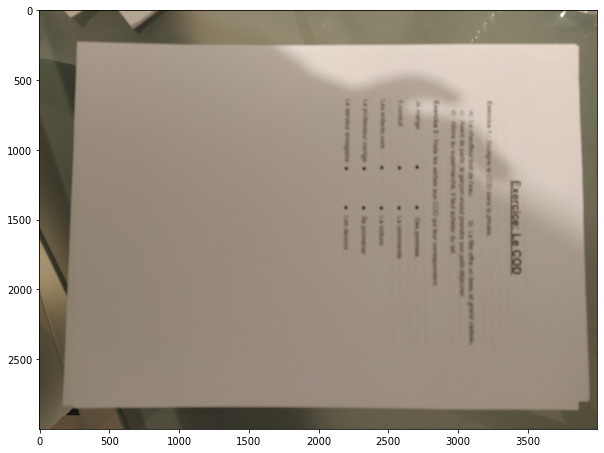

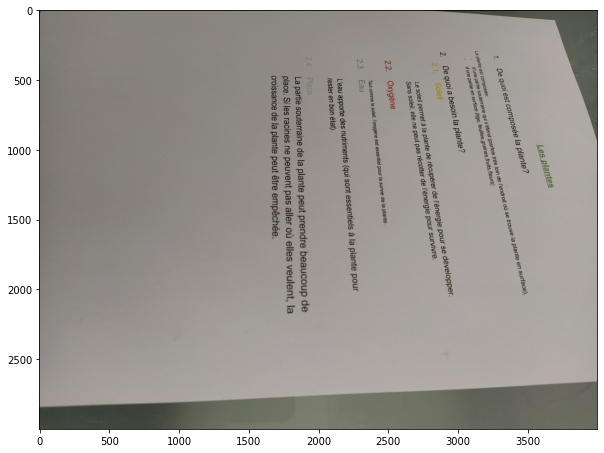

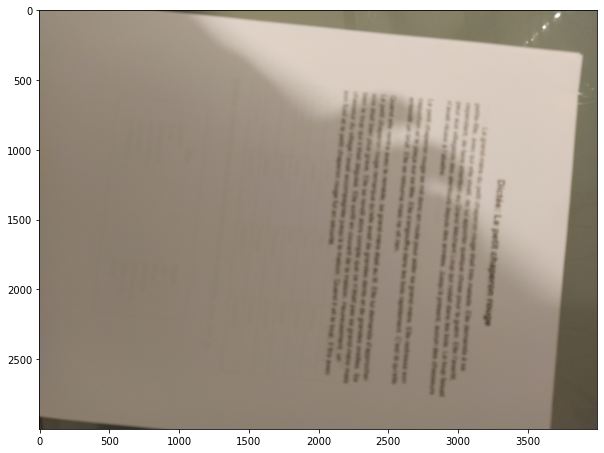

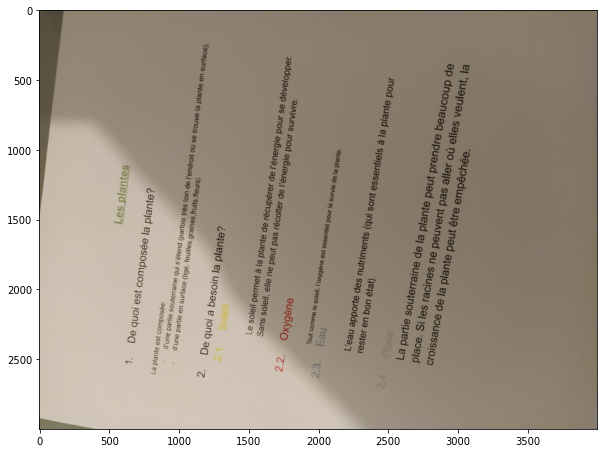

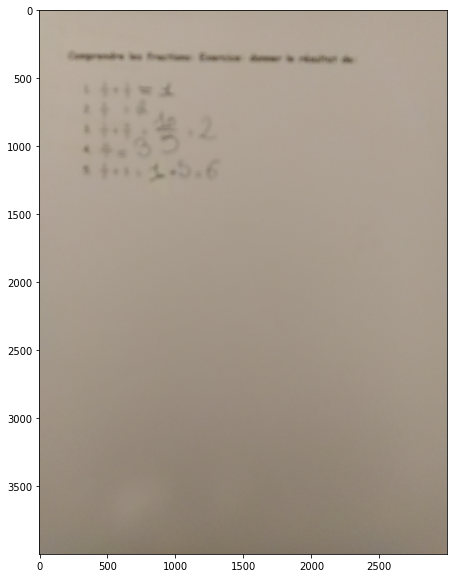

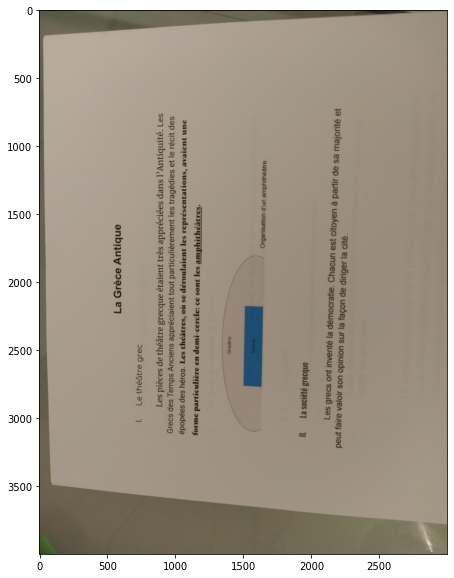

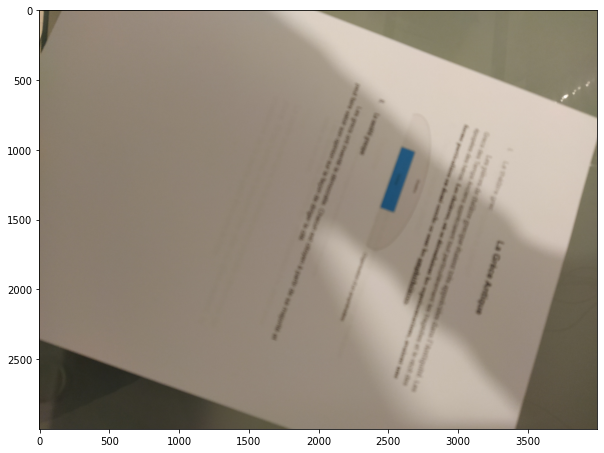

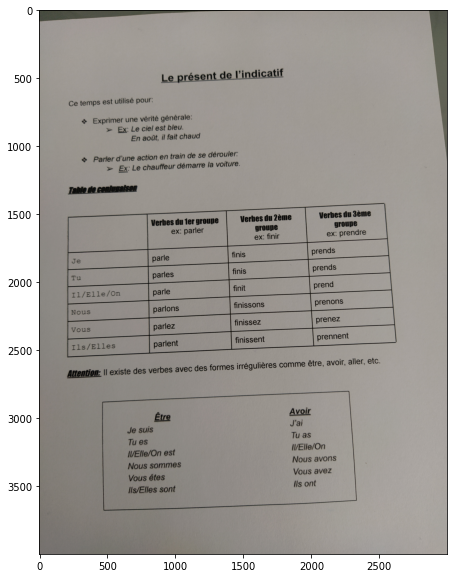

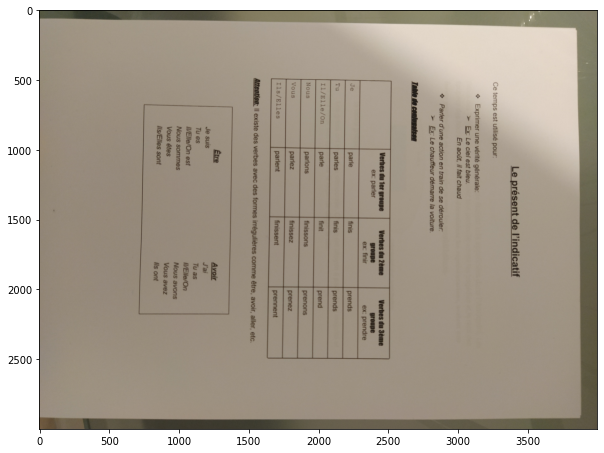

In [46]:
for p in img_to_try:
    img = load_image(p)
    plot_image(img)

These images do not have the good rotation. So we need to rotate them.

../Exemples/Ex_Maths/IMG_20210329_122221.jpg


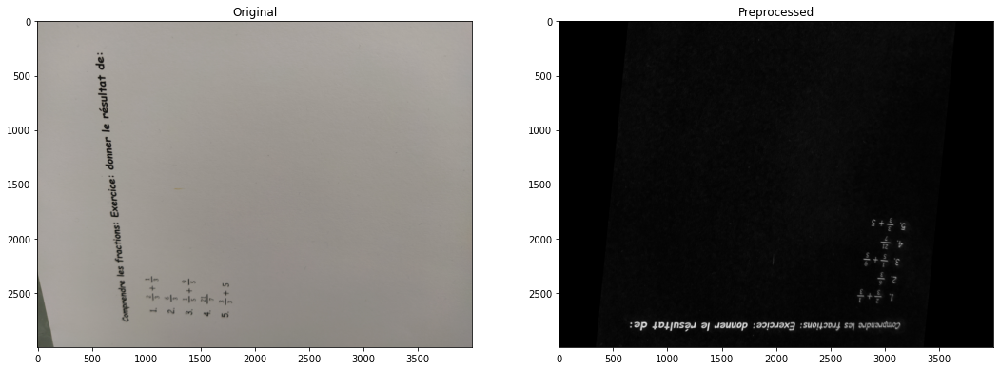

../Exemples/Ex_COD/IMG_20210329_122755.jpg


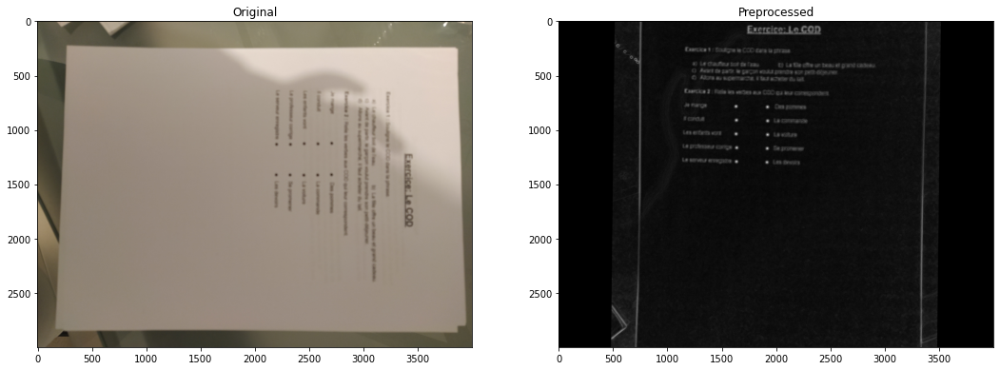

../Exemples/SVT/IMG_20210329_122633.jpg


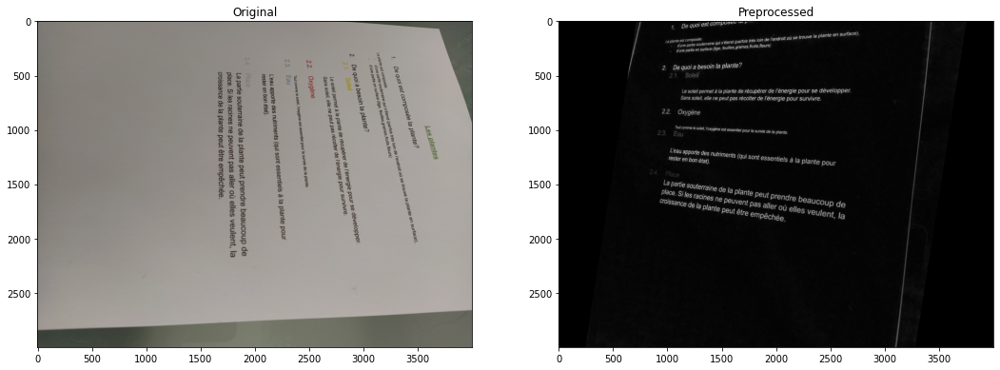

../Exemples/Dictee/IMG_20210329_122825.jpg


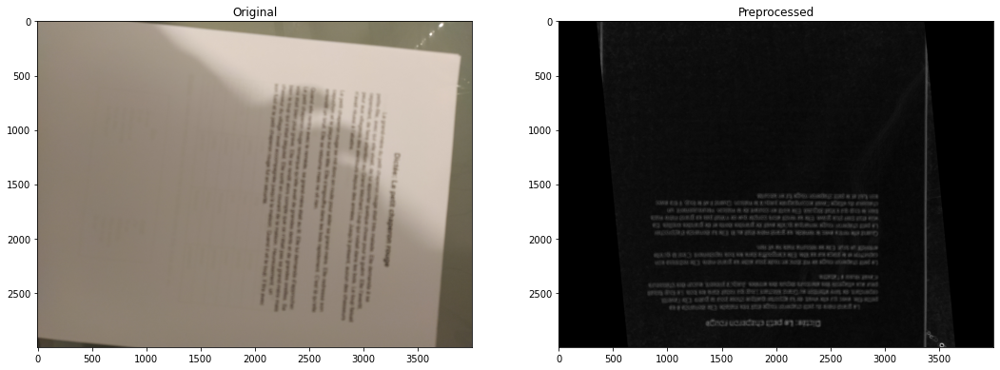

../Exemples/SVT/IMG_20210329_123021.jpg


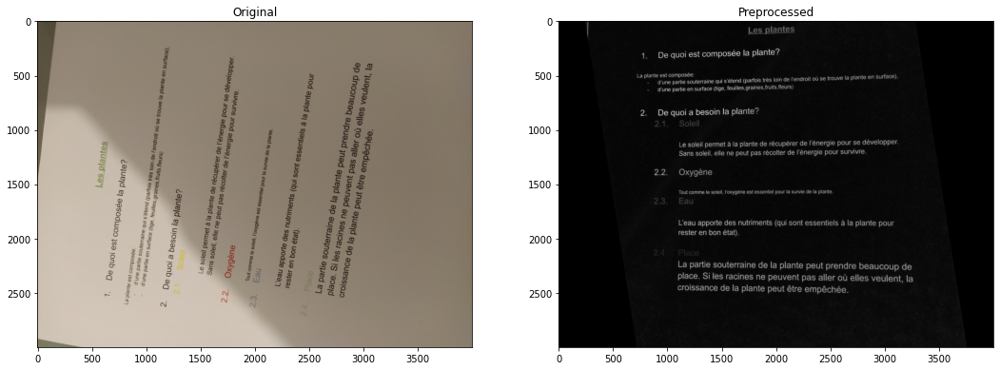

../Exemples/Ex_Maths/IMG_20210329_123813.jpg


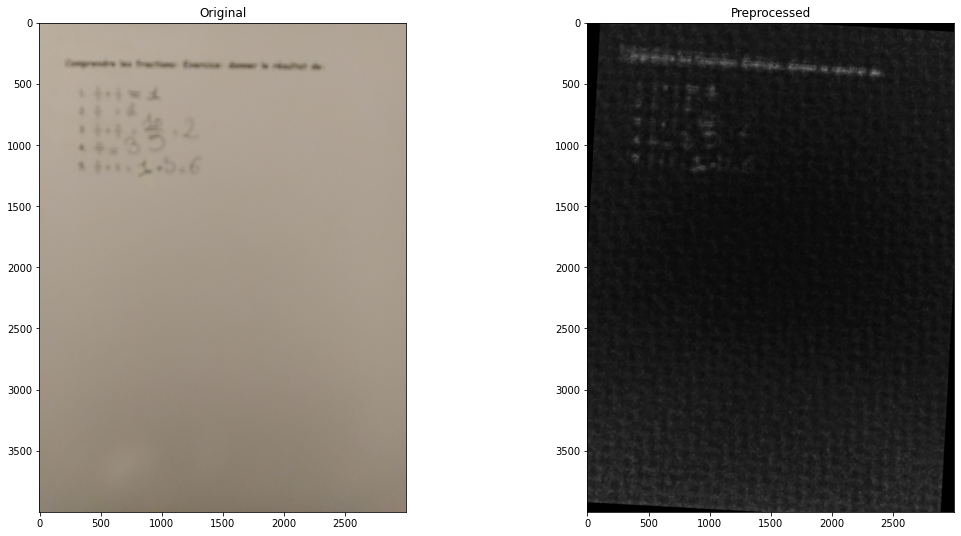

../Exemples/Histoire_Geo/IMG_20210329_123005.jpg


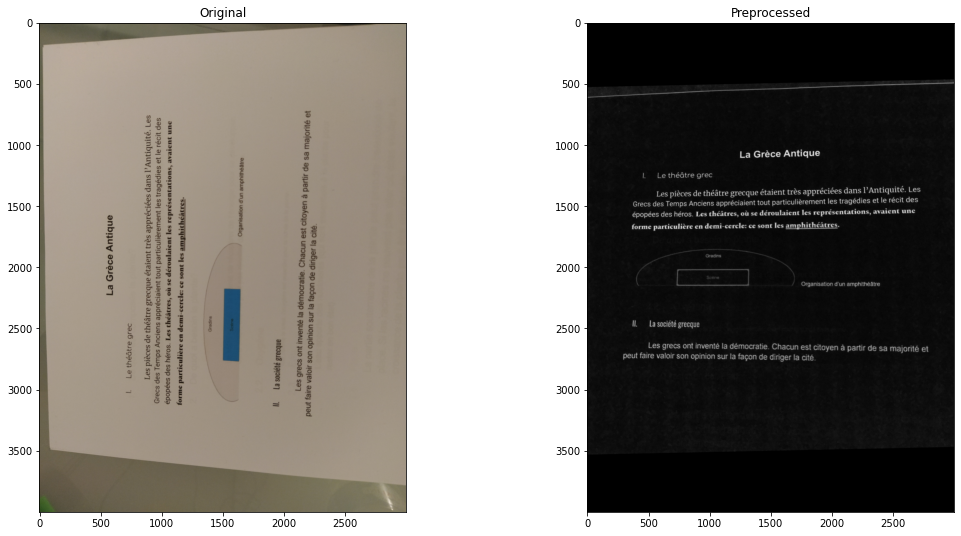

../Exemples/Histoire_Geo/IMG_20210329_122940.jpg


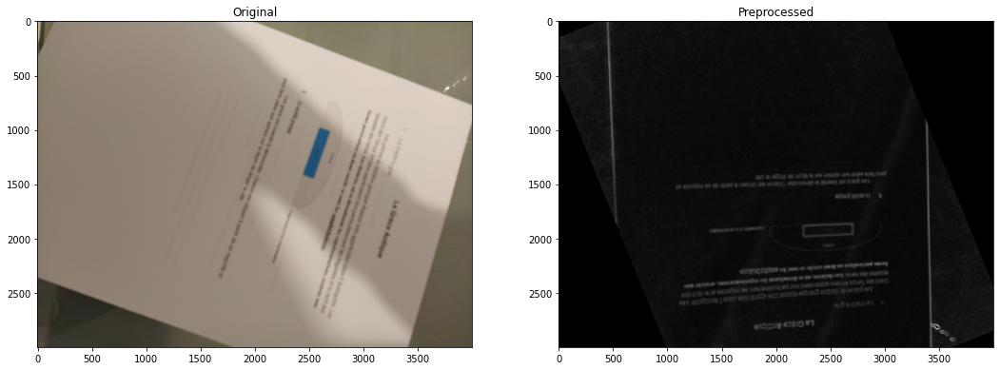

../Exemples/Present_indicatif/IMG_20210329_122406.jpg


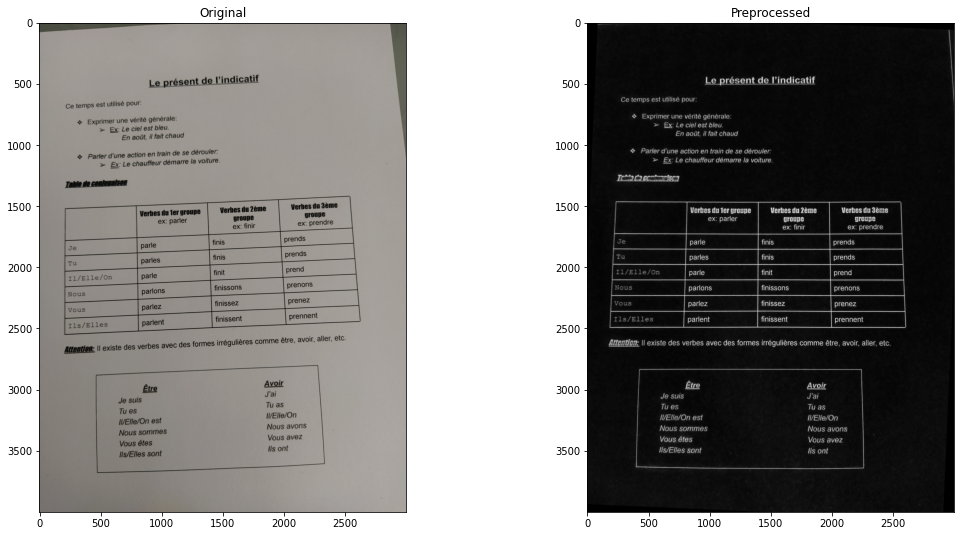

../Exemples/Present_indicatif/IMG_20210329_122915.jpg


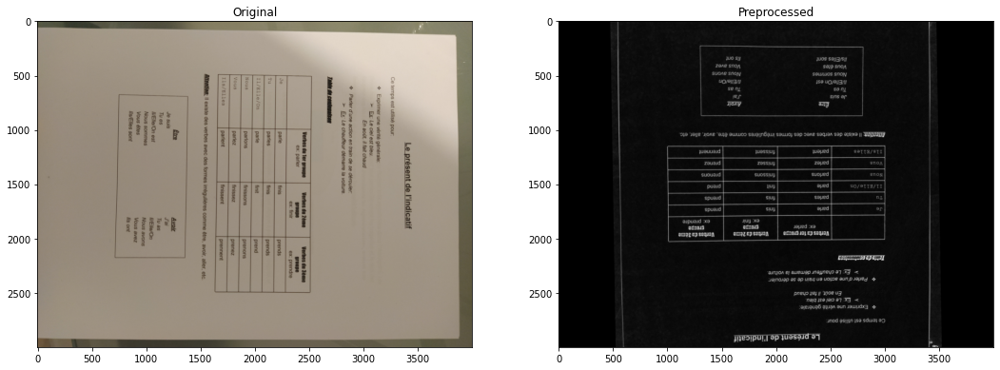

In [308]:
times = {
    'load':[],
    'compute_angle':[],
    'rotation':[],
}
    
for p in img_to_try:#[2:5]:
    print(p)
    
    t0 = time.time()
    img = load_image(p)
    img_no_shadow = preprocessing.remove_shadow(img)
    _img = preprocessing.image_to_gray(img_no_shadow)
    times['load'].append(time.time() - t0)
    
    t0 = time.time()
    angle = find_best_rotation_angle(_img)
    times['compute_angle'].append(time.time() - t0)
    
    t0 = time.time()
    img_rotated = preprocessing.rotate_img(_img, angle)
    times['rotation'].append(time.time() - t0)
    
    plot_2_images(img, img_rotated)

In [307]:
for k, v in times.items():
    print('mean time for %s: %.2fs (std = %.2fs)'%(k, np.mean(v), np.std(v)))

mean time for load: 1.25s (std = 0.05s)
mean time for compute_angle: 0.34s (std = 0.12s)
mean time for rotation: 0.02s (std = 0.00s)


Based on this we can construct the pipeline.


## First preprocessed pipeline

If we want to get better results, we need to put the image with a correct text orientation on the `tesseract` model and also shadows on an picture can be a problem.

So I propose this preprocess pipeline:

1. Load image
2. Remove shadow
3. To grayscale with threshold (black and white)
4. Find best angle direction to rotate the image
5. Rotate image and extract text
6. Rotate image 180 (since we only have the direction) and extract text

In [329]:
def preprocess_image(image):    
    image_no_shadow = preprocessing.remove_shadow(image)
    
    image_gray = preprocessing.image_to_gray(image_no_shadow, threshold=True)

    angle = preprocessing.find_best_rotation_angle(image_gray)

    image_fixed = preprocessing.rotate_img(image_gray, angle=angle)
    
    return image_fixed

def pipeline(fpath):
    image_orig = load_image(fpath)
    image_prep = preprocess_image(image_orig)
    
    # text = extract_text_from_image(image_prep)
    
    # TODO : if text is ok then no need to compute next 
    # return text
    
    image_prep_180 = preprocessing.rotate_img(image_prep, 180)
    # text_180 = extract_text_from_image(image_prep_180)
    
    return [image_orig, image_prep, image_prep_180] #, (text, text_180)


In [336]:
from IPython.display import display, HTML
import pandas as pd

def pretty_print(df):
    return display( HTML( df.to_html().replace("\\n","<br>") ) )


def plot_n_images(images, figsize=(18, 9)):
    """Plots original image and the processed one

    Parameters
    ----------
    img1 : np.ndarray
        Original image
    img2 : np.ndarray
        Preprocessed image
    figsize : tuple, default (18, 9)
        Figure size
    gray: tuple(bool), default (False, True)
        Whether it's a grayscale image or not
    """
    fig, axes = plt.subplots(1, len(images), figsize=figsize)

    for idx, ax in enumerate(axes):
        if len(images[idx].shape) == 3:
            ax.imshow(images[idx])
        else:
            ax.imshow(images[idx], cmap='gray')

    plt.show()
    
def run_preprocess_on_file(fpath):
    t0 = time.time()
    images = pipeline(fpath)
    t_end = time.time() - t0
    
    print('Run in %.2fs'%t_end)

    plot_n_images(images, figsize=(25,8))

def run_preprocess_on_files(files):
    
    for fpath in files:
        print(fpath)
        run_preprocess_on_file(fpath)
    

### test pipeline

Run in 2.30s


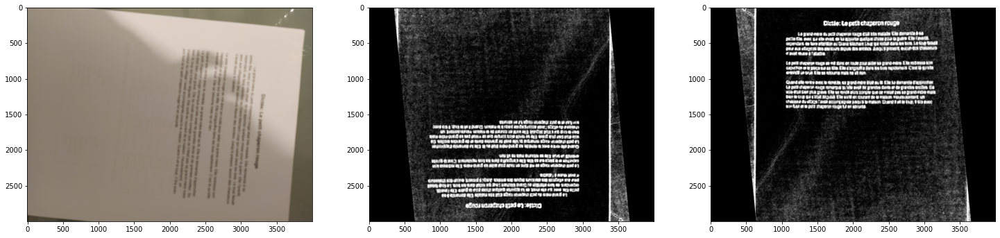

In [337]:
p = '../Exemples/Dictee/IMG_20210329_122825.jpg'
run_preprocess_on_file(p)

### On all files

../Exemples/Ex_Maths/IMG_20210329_123828.jpg
Run in 1.62s


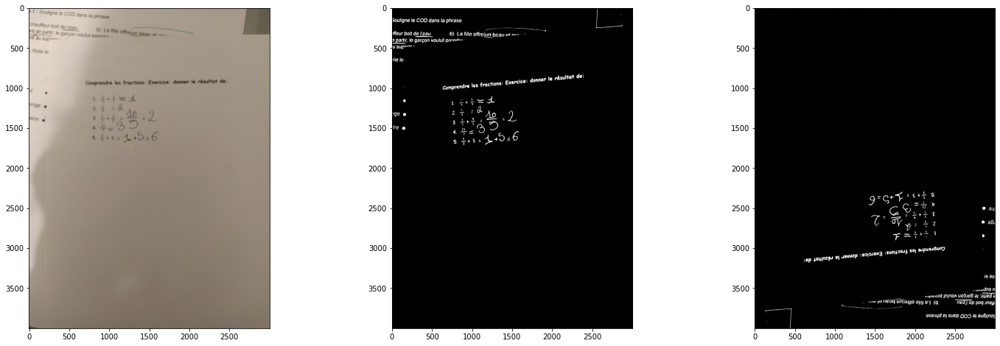

../Exemples/Ex_Maths/IMG_20210329_122221.jpg
Run in 1.25s


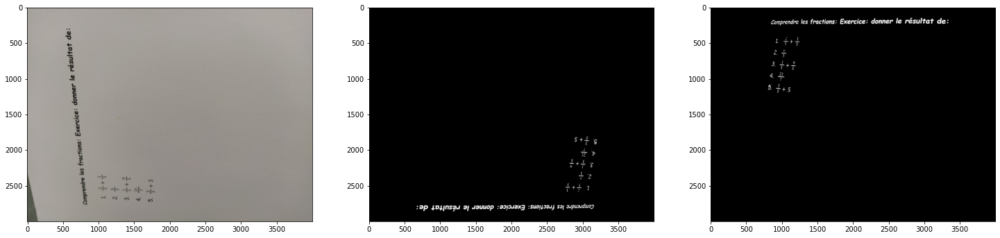

../Exemples/Ex_Maths/IMG_20210329_123818.jpg
Run in 1.38s


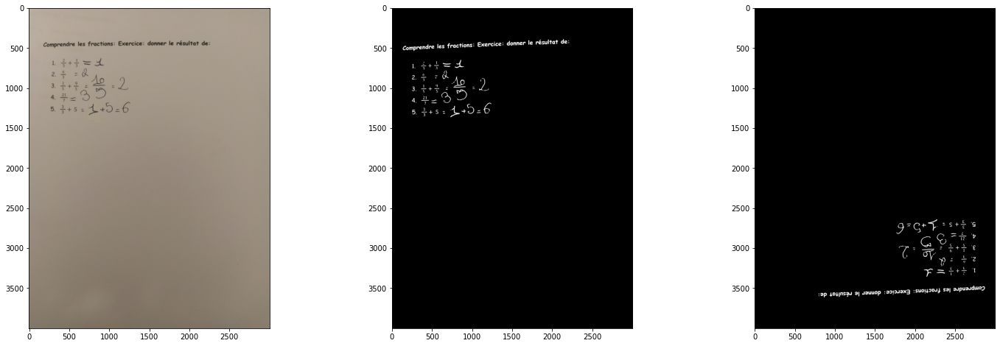

../Exemples/Ex_Maths/IMG_20210329_122227.jpg
Run in 1.26s


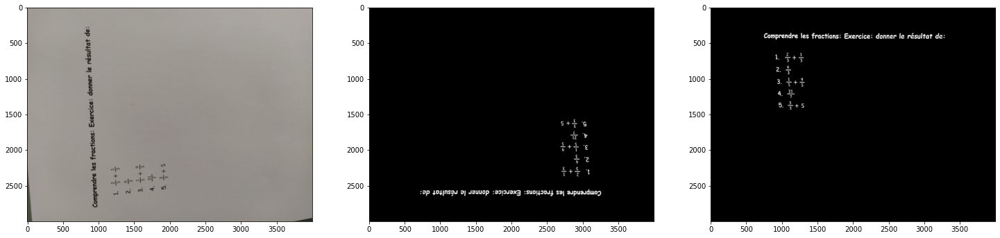

../Exemples/Ex_Maths/IMG_20210329_122202.jpg
Run in 1.38s


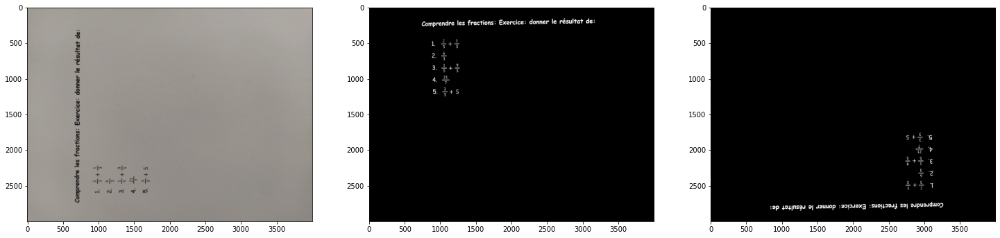

../Exemples/Ex_Maths/IMG_20210329_122715.jpg
Run in 1.25s


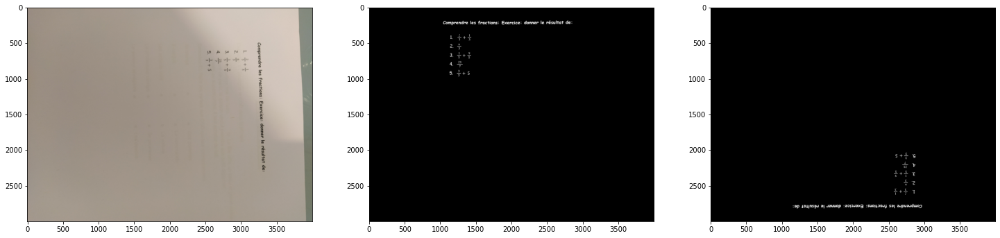

../Exemples/Ex_Maths/IMG_20210329_122724.jpg
Run in 1.30s


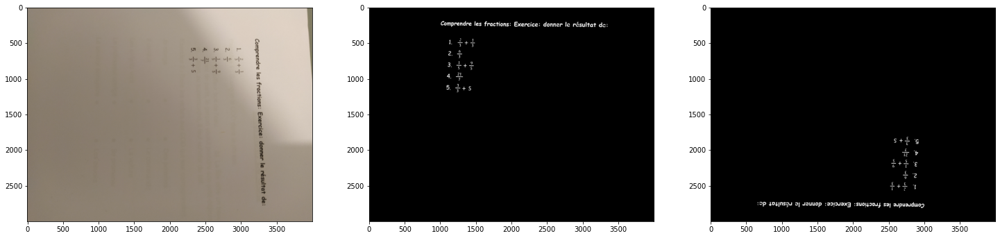

../Exemples/Ex_Maths/IMG_20210329_123813.jpg
Run in 2.23s


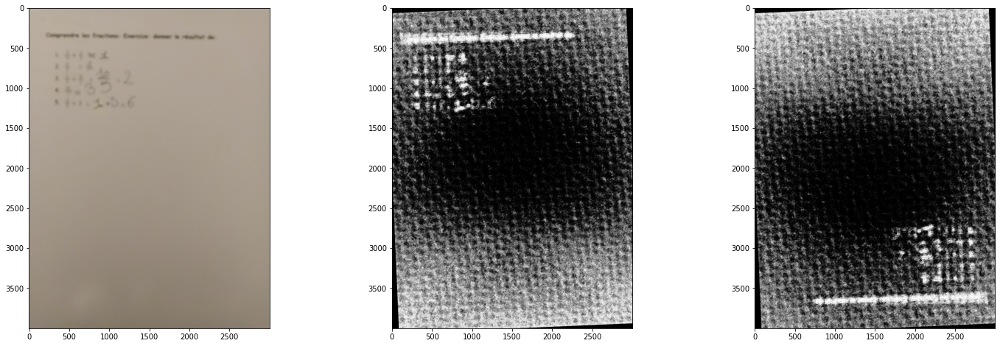

../Exemples/Ex_Maths/IMG_20210329_122157.jpg
Run in 1.22s


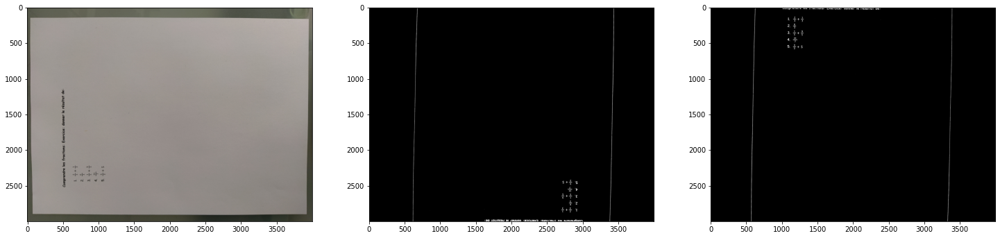

../Exemples/Ex_Maths/IMG_20210329_122738.jpg
Run in 1.71s


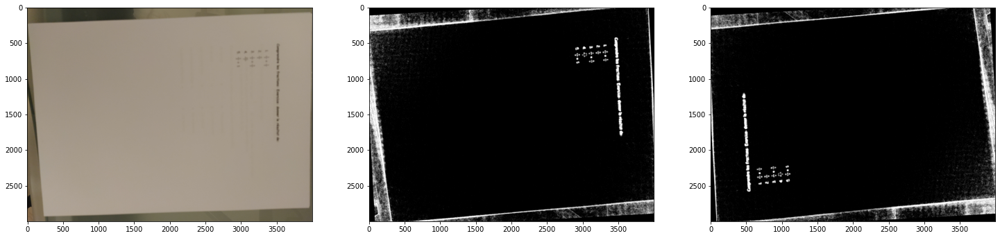

../Exemples/Histoire_Geo/IMG_20210329_122543.jpg
Run in 1.66s


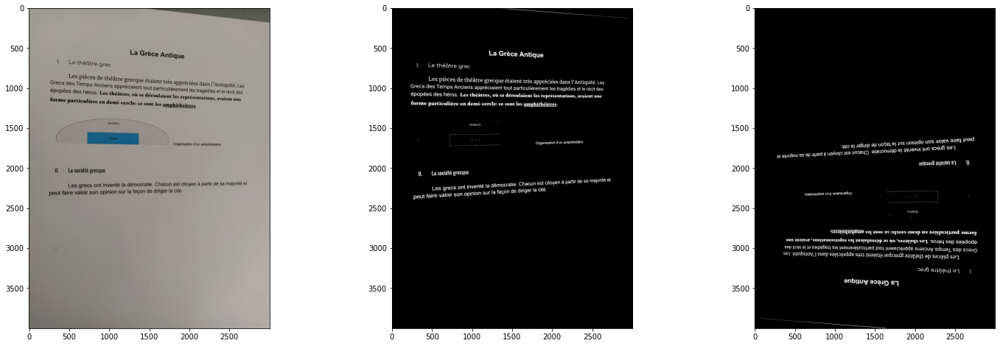

../Exemples/Histoire_Geo/IMG_20210329_123005.jpg
Run in 1.65s


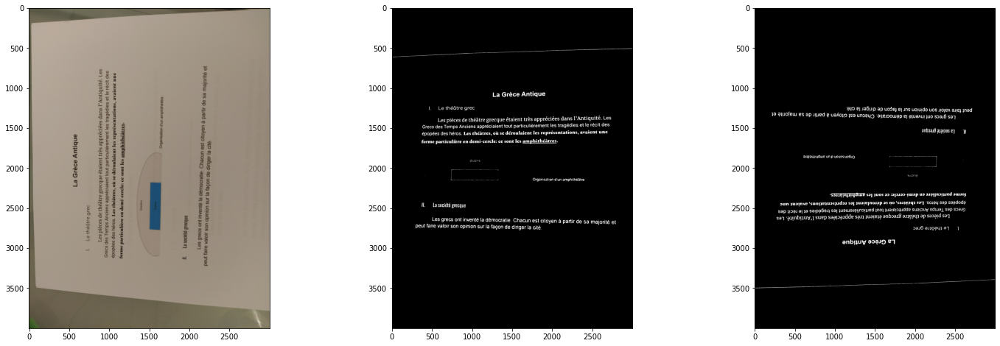

../Exemples/Histoire_Geo/IMG_20210329_122940.jpg
Run in 1.98s


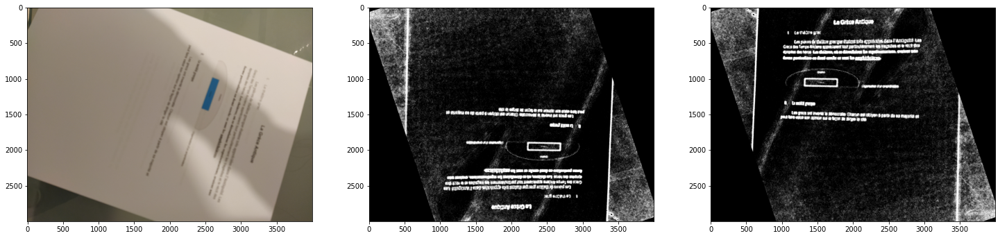

../Exemples/Histoire_Geo/IMG_20210329_123000.jpg
Run in 1.46s


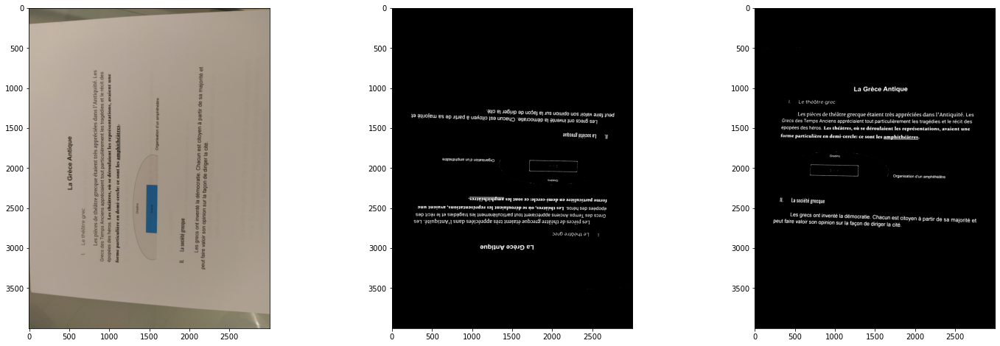

../Exemples/Histoire_Geo/IMG_20210329_122932.jpg
Run in 1.50s


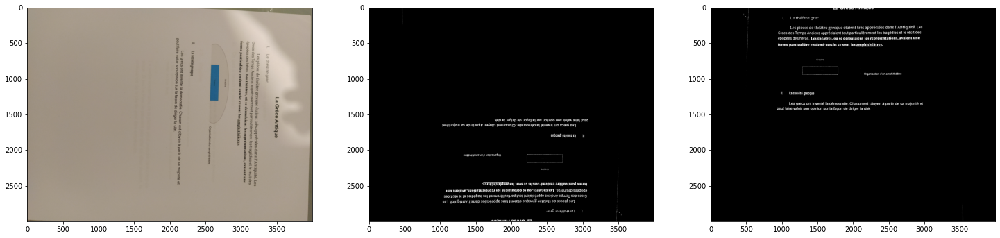

../Exemples/Histoire_Geo/IMG_20210329_122524.jpg
Run in 1.18s


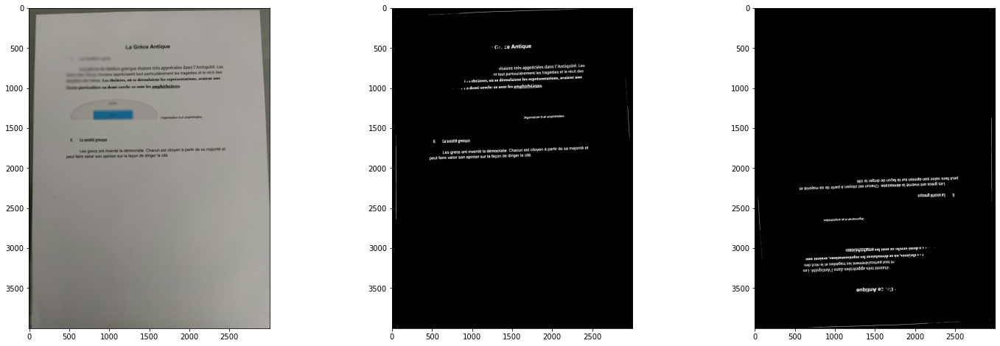

../Exemples/Histoire_Geo/IMG_20210329_122536.jpg
Run in 1.43s


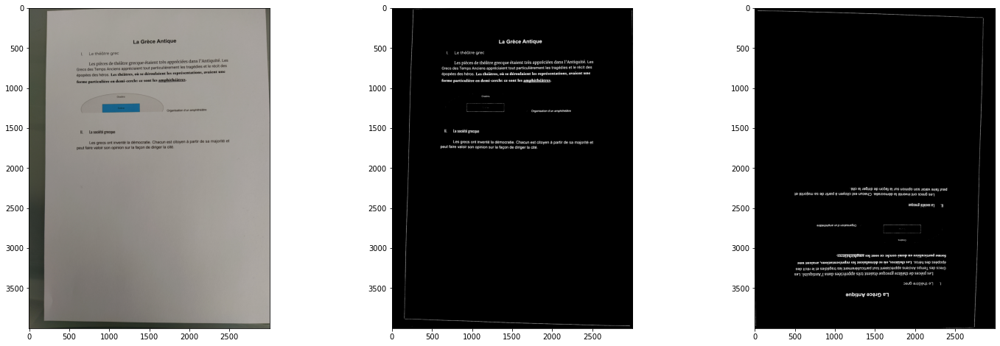

../Exemples/Dictee/IMG_20210329_122324.jpg
Run in 1.39s


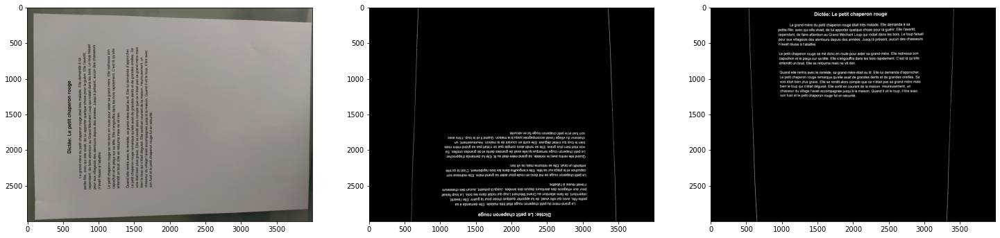

../Exemples/Dictee/IMG_20210329_122825.jpg
Run in 2.42s


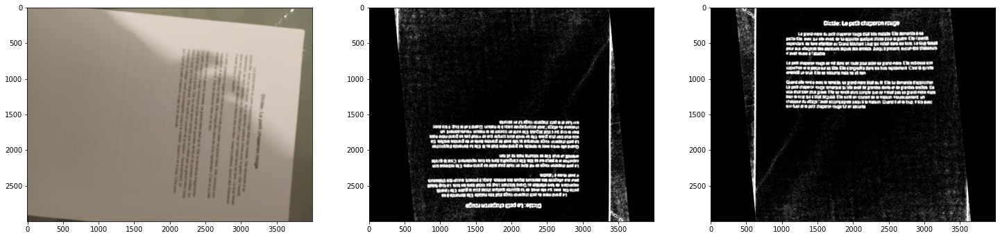

../Exemples/Dictee/IMG_20210329_122839.jpg
Run in 1.39s


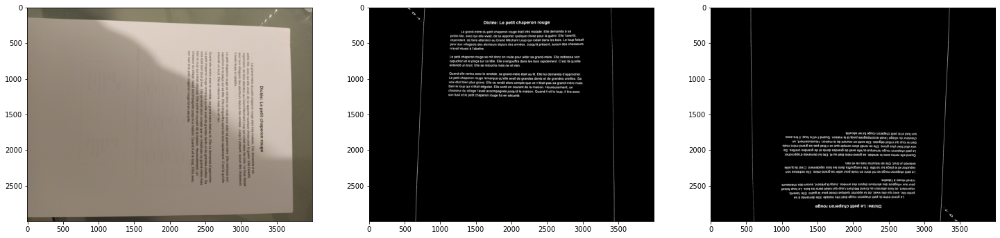

../Exemples/Dictee/IMG_20210329_122828.jpg
Run in 1.76s


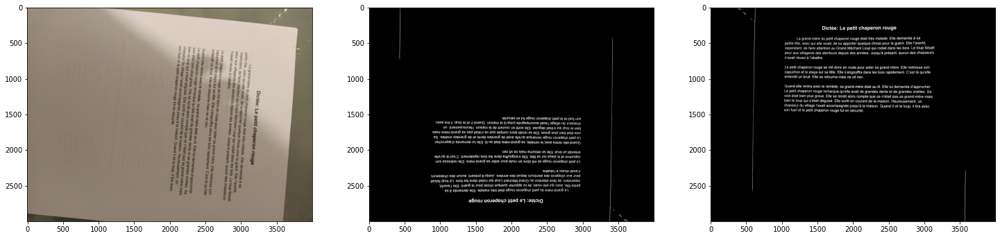

../Exemples/SVT/IMG_20210329_123138.jpg
Run in 1.44s


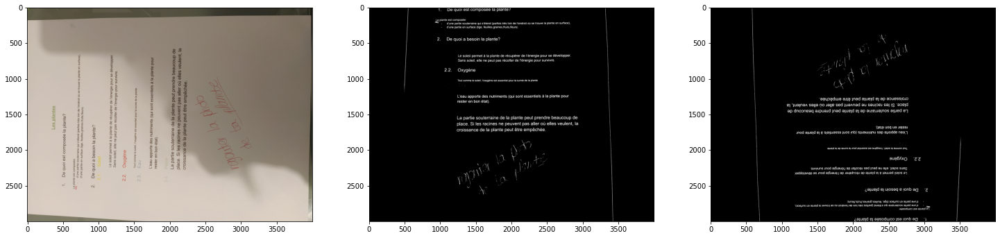

../Exemples/SVT/IMG_20210329_122617.jpg
Run in 1.18s


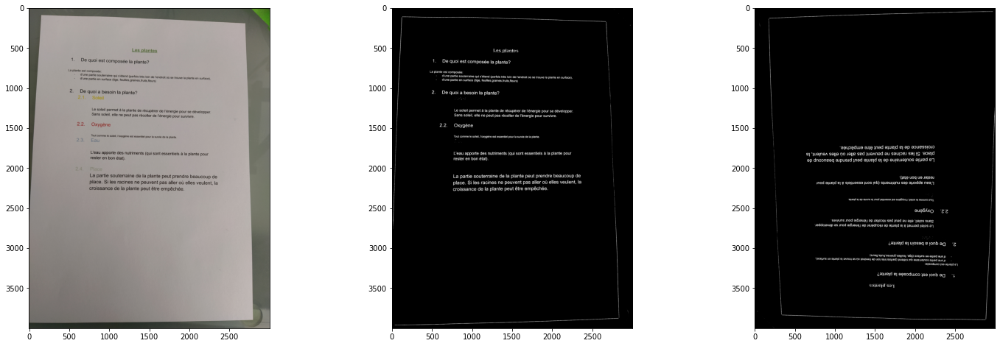

../Exemples/SVT/IMG_20210329_122614.jpg
Run in 1.43s


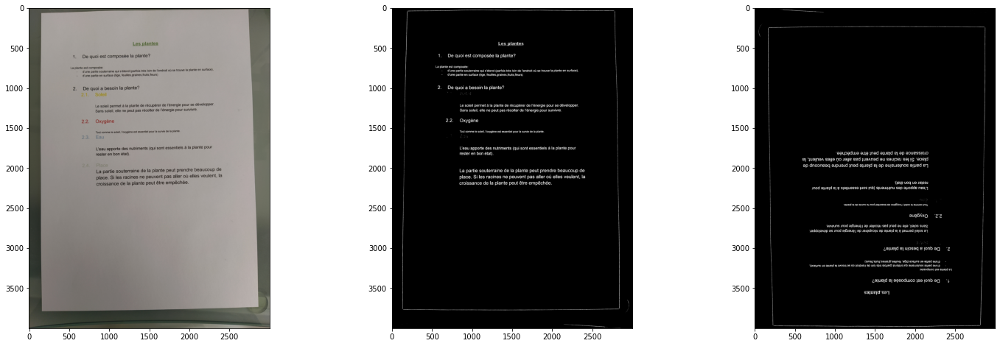

../Exemples/SVT/IMG_20210329_123021.jpg
Run in 1.67s


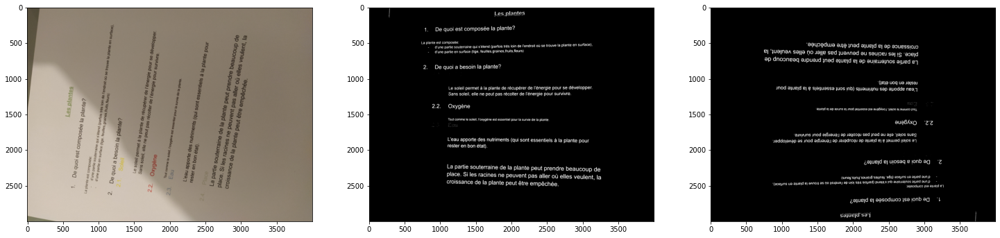

../Exemples/SVT/IMG_20210329_122633.jpg
Run in 1.47s


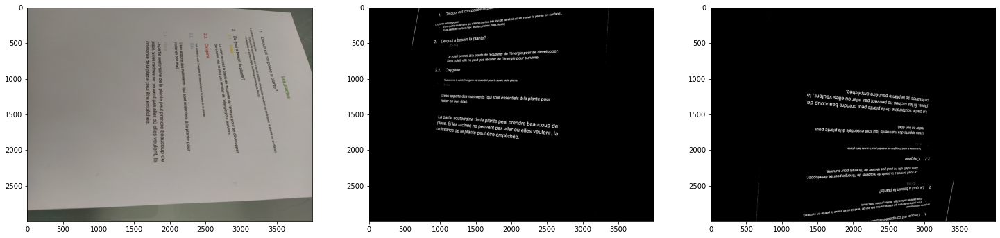

../Exemples/SVT/IMG_20210329_122621.jpg
Run in 1.60s


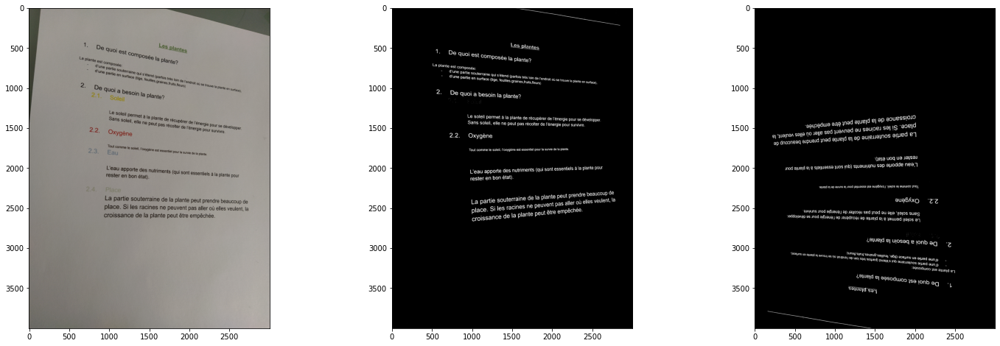

../Exemples/SVT/IMG_20210329_122629.jpg
Run in 1.52s


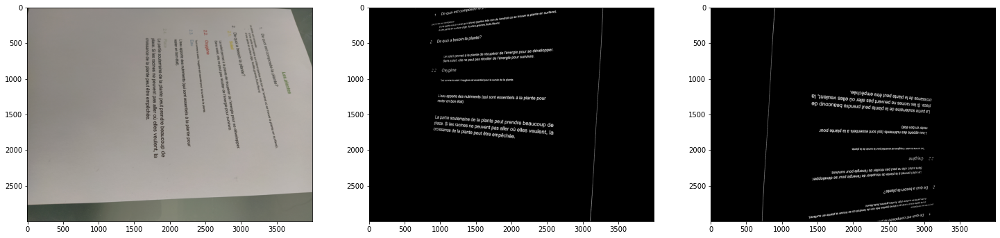

../Exemples/SVT/IMG_20210329_123025.jpg
Run in 1.49s


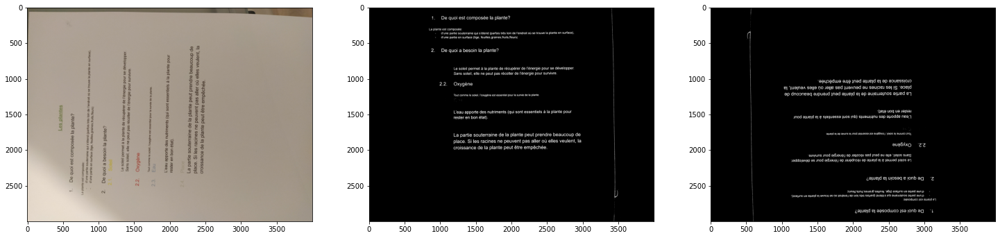

../Exemples/SVT/IMG_20210329_123017.jpg
Run in 1.78s


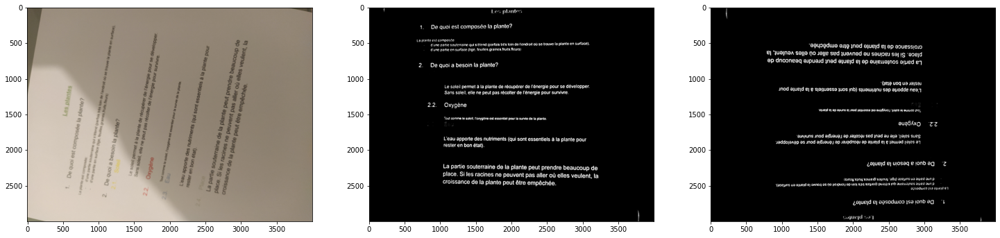

../Exemples/SVT/IMG_20210329_123029.jpg
Run in 1.38s


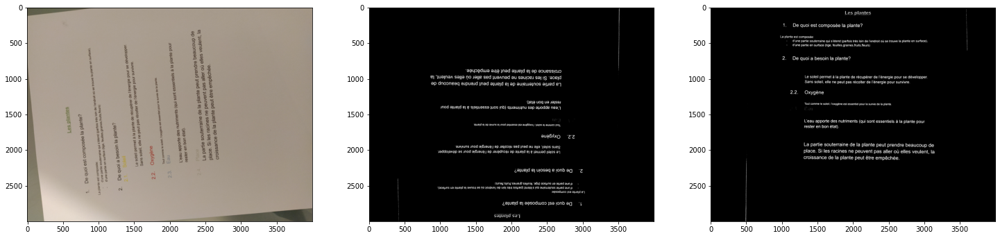

../Exemples/SVT/IMG_20210329_123132.jpg
Run in 1.70s


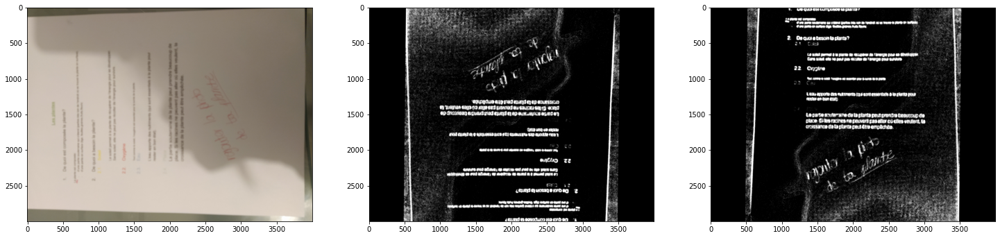

../Exemples/Ex_COD/IMG_20210329_122814.jpg
Run in 1.28s


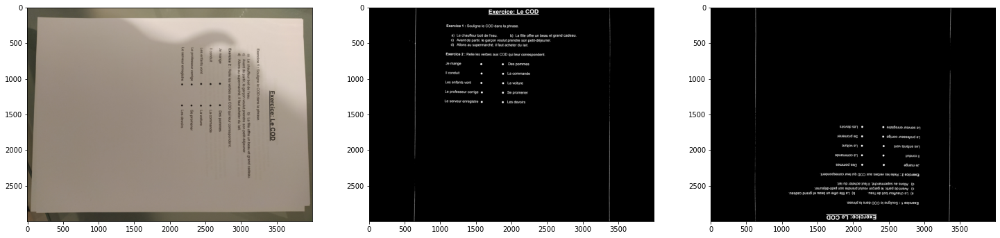

../Exemples/Ex_COD/IMG_20210329_122809.jpg
Run in 1.85s


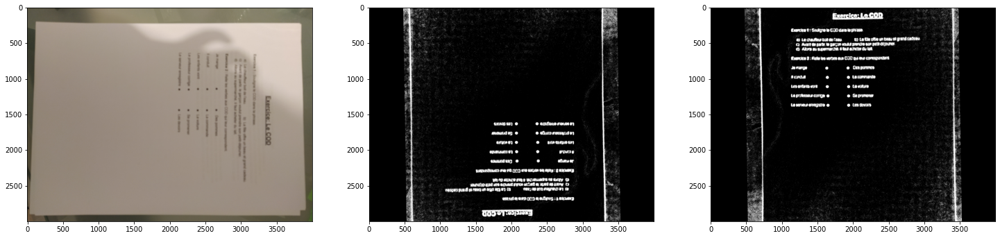

../Exemples/Ex_COD/IMG_20210329_122251.jpg
Run in 1.34s


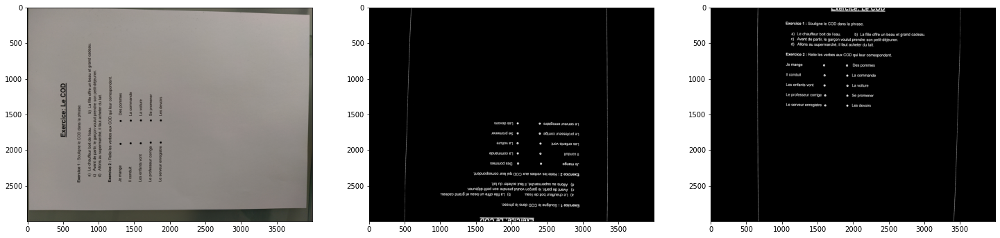

../Exemples/Ex_COD/IMG_20210329_123624.jpg
Run in 1.63s


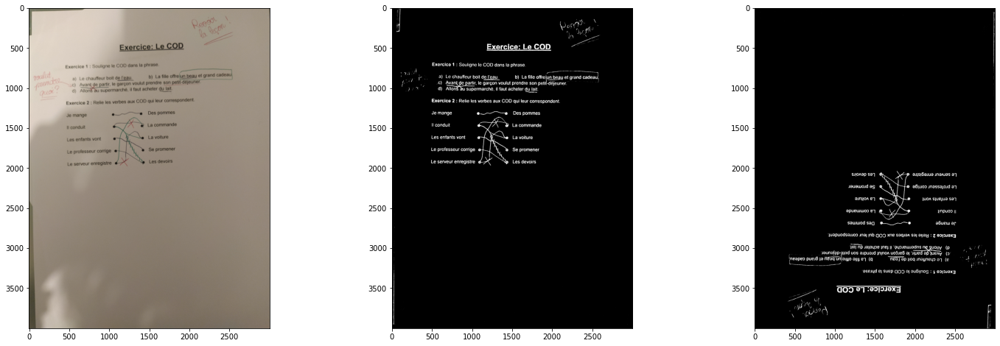

../Exemples/Ex_COD/IMG_20210329_122300.jpg
Run in 1.42s


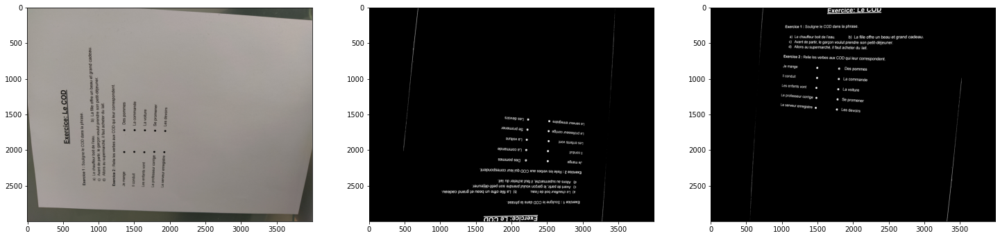

../Exemples/Ex_COD/IMG_20210329_123633.jpg
Run in 1.60s


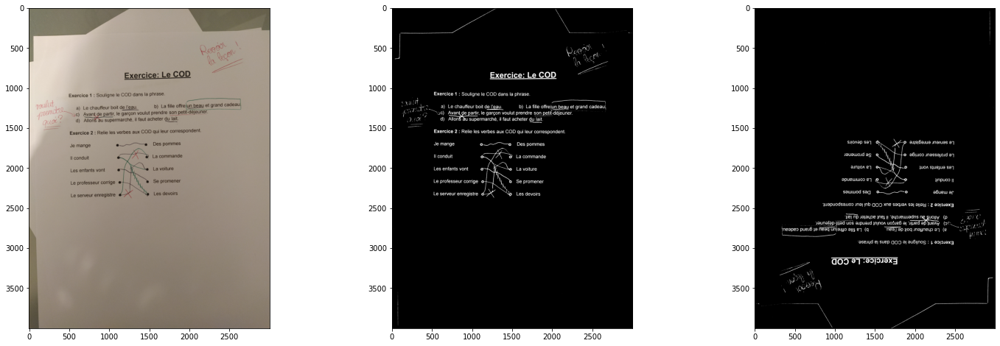

../Exemples/Ex_COD/IMG_20210329_122755.jpg
Run in 1.83s


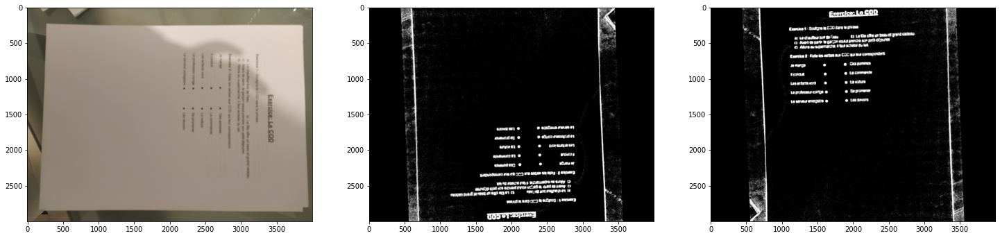

../Exemples/Ex_COD/IMG_20210329_122306.jpg
Run in 1.43s


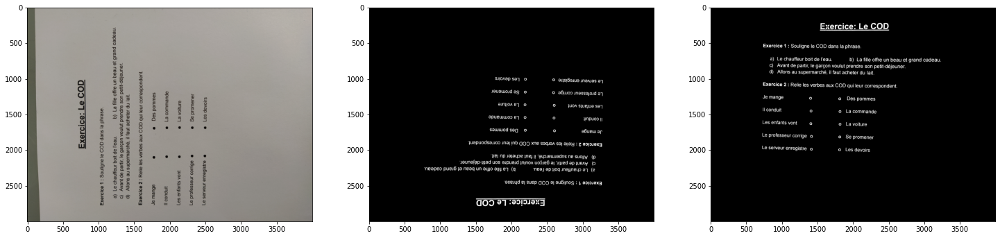

../Exemples/Present_indicatif/IMG_20210329_122401.jpg
Run in 2.05s


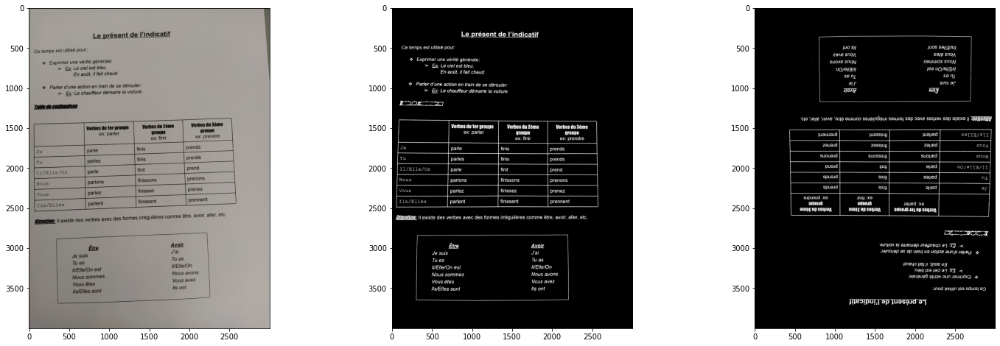

../Exemples/Present_indicatif/IMG_20210329_122910.jpg
Run in 2.02s


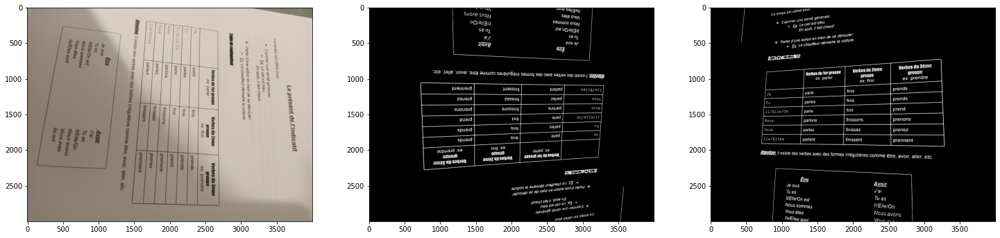

../Exemples/Present_indicatif/IMG_20210329_122337.jpg
Run in 1.73s


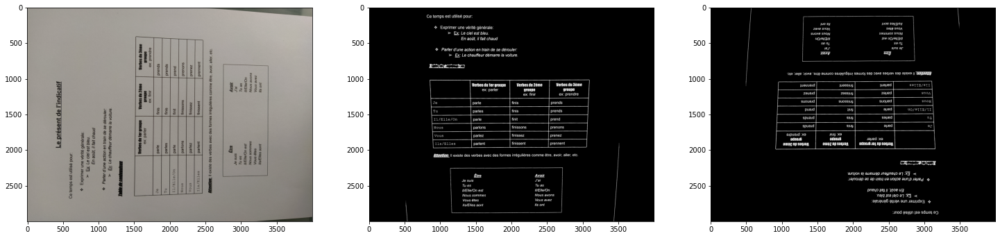

../Exemples/Present_indicatif/IMG_20210329_122915.jpg
Run in 2.01s


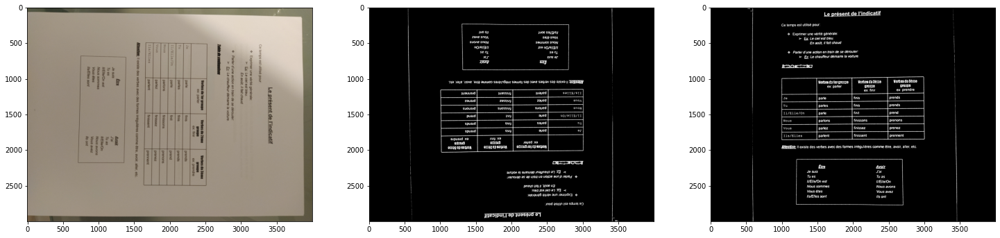

../Exemples/Present_indicatif/IMG_20210329_122904.jpg
Run in 1.96s


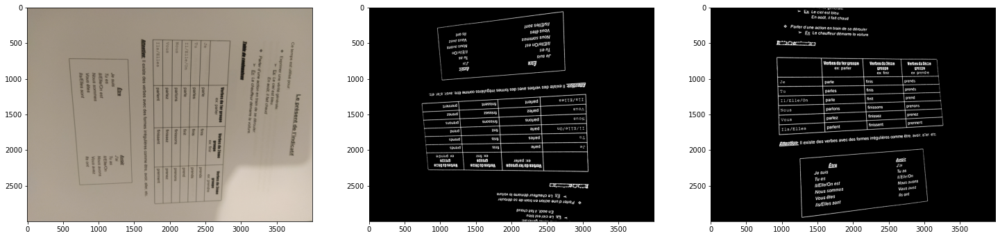

../Exemples/Present_indicatif/IMG_20210329_122857.jpg
Run in 1.74s


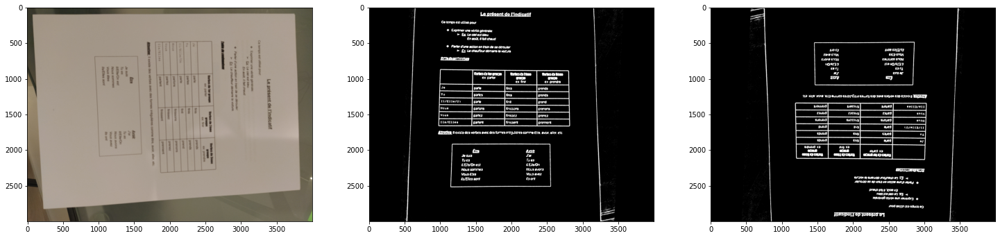

../Exemples/Present_indicatif/IMG_20210329_122406.jpg
Run in 2.00s


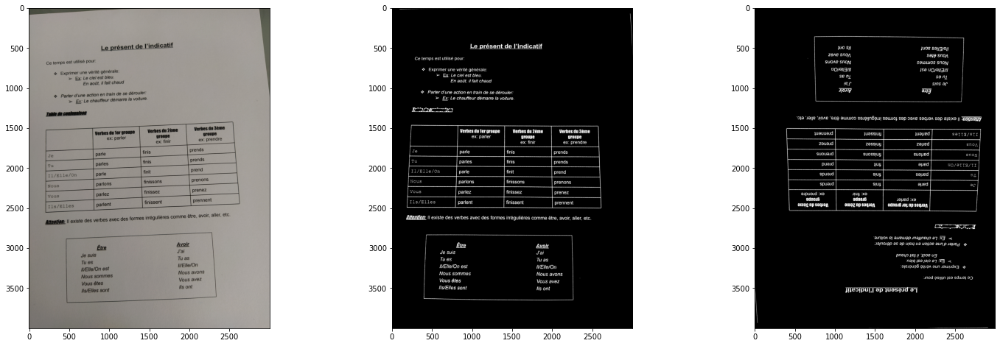

../Exemples/Present_indicatif/IMG_20210329_122343.jpg
Run in 1.69s


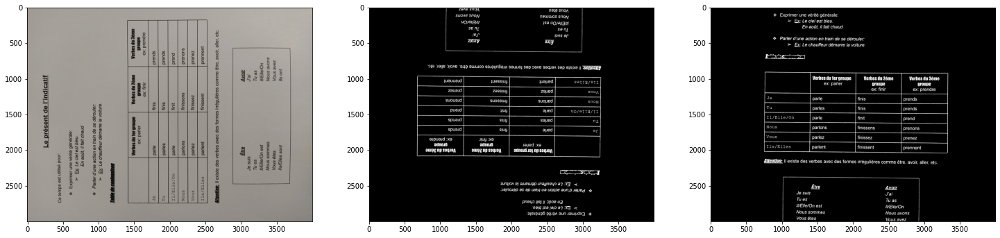

In [338]:
run_preprocess_on_files(all_files)